NetID: leahnl2

Assignment: Lab 3

Grade: _ / _

Comments:


# CS448 - Lab 3: Artificial Reverberation and Room Simulation


In this lab we will get some experience in simulating rooms digitally. We will design some simple reverbs using small filters and then work towards a more principled room simulator. You can use whichever sound you like for the following examples, usually a sound with sharp onsets is good for such experiments. One good example is the drum loop [ https://drive.google.com/uc?export=download&id=16mqI3xFN00AK5bP5k1VYJiEfH7ghHHSf ]

## Part 1. Designing simple reverb using filters

The simplest forms of reverbs can be designed using simple delays, comb and allpass filters. We will design one of each to get started.

a) A room with a single wall. For this reverb we will assume that we have a room that only has one reflective wall as shown below. Design a filter that simulates what the microphone will record. Figure out the right filter in the case where $d_i = [0.2, 1]$ meters, and in the case where $d_i = [2, 10]$ meters. Let me know what the differences between these sounds are. To keep things simple, round the delays to an integer number and make up an approximate gain loss due to propagation and the wall bounce.

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import scipy
import utils

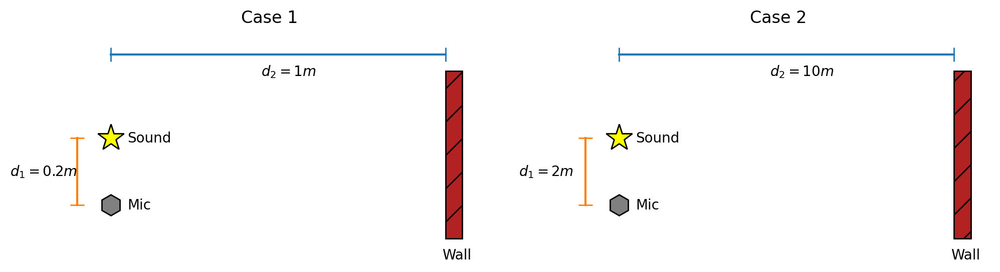

In [4]:
from matplotlib.pylab import gca, gcf, figure
from matplotlib.patches import Rectangle
%config InlineBackend.figure_format = 'retina'

figure( figsize=(12,3), facecolor='w')
gcf().add_subplot( 1, 2, 1, title='Case 1', frameon=False, xticks=[], yticks=[])
gca().plot( 0, 0, 'h', color='grey', markeredgecolor='k', markersize=15)
gca().plot( 0, .2, '*', color='yellow', markeredgecolor='k', markersize=20)
gca().plot( [0,1], [.45,.45], marker='|', markersize=10)
gca().plot( [-.1,-.1], [0,.2], marker='_', markersize=10)
gca().add_patch( Rectangle( (1,-.1), .05, .5, facecolor='firebrick', edgecolor='k', hatch='/'))
[gca().text(x+.05,y,t,va='center',ha='left') 
    for x,y,t in zip( [0,0,-.35,.4,.94], [0,.2,.1,.4,-.15], ['Mic','Sound','$d_1=0.2m$', '$d_2=1m$', 'Wall'])]
gca().axis( 'equal')

gcf().add_subplot( 1, 2, 2, title='Case 2', frameon=False, xticks=[], yticks=[])
gca().plot( 0, 0, 'h', color='grey', markeredgecolor='k', markersize=15)
gca().plot( 0, .2, '*', color='yellow', markeredgecolor='k', markersize=20)
gca().plot( [0,1], [.45,.45], marker='|', markersize=10)
gca().plot( [-.1,-.1], [0,.2], marker='_', markersize=10)
gca().add_patch( Rectangle( (1,-.1), .05, .5, facecolor='firebrick', edgecolor='k', hatch='/'))
[gca().text(x+.05,y,t,va='center',ha='left') 
    for x,y,t in zip( [0,0,-.35,.4,.94], [0,.2,.1,.4,-.15], ['Mic','Sound','$d_1=2m$', '$d_2=10m$', 'Wall'])]
gca().axis( 'equal');

In [5]:
# load and play drum loop sound
drum_sr, drum_x = utils.wavreadurl("https://drive.google.com/uc?export=download&id=16mqI3xFN00AK5bP5k1VYJiEfH7ghHHSf")
utils.sound(drum_x, drum_sr, "drum loop (original)")

drum loop (original)


In [6]:
# YOUR CODE HERE

# function that models simple reverb ... y[t] = x[t] + g x[t − N] ... y = [1, 0, ⋯ , 0, g] ∗ x
def simple_echo(input_sound, sr, d1, d2, g):
    # calculate N (i.e. the delay) ... following Slide 42 diagram
    speed_of_sound = 343 # units are m/s
    N = int(((np.sqrt(d1**2 + (2 * d2)**2)) / speed_of_sound) * sr)

    # set up numerator for convolution (non-recursive)
    b = np.zeros(N + 1)
    b[0] = 1
    b[-1] = g

    # compute reverb
    reverb = scipy.signal.lfilter(b, [1], input_sound)
    return reverb

# case 1: d1=0.2m and d2=1m
simple_reverb1 = simple_echo(drum_x, drum_sr, 0.2, 1, 0.5)
utils.sound(simple_reverb1, drum_sr, "drum loop (case 1 - simple reverb)")

# case 2: d1=2m and d2=10m
simple_reverb2 = simple_echo(drum_x, drum_sr, 2, 10, 0.5)
utils.sound(simple_reverb2, drum_sr, "drum loop (case 2 - simple reverb)")


drum loop (case 1 - simple reverb)


drum loop (case 2 - simple reverb)


The difference between these is ... the delay of the echo. Since the sound travels farther to the wall and back in case 2, there is a more noticeable delay in the corresponding output sound. On the other hand, the reverb in case 1 is much more subtle and doesn't have as large of a delay, so it isn't as audible.

b) Now we will use a room geometry as shown below. Design the proper filter again, for $d = 1$ meters and then for $d = 10$ meters. Comment on the audible differences between these two settings.

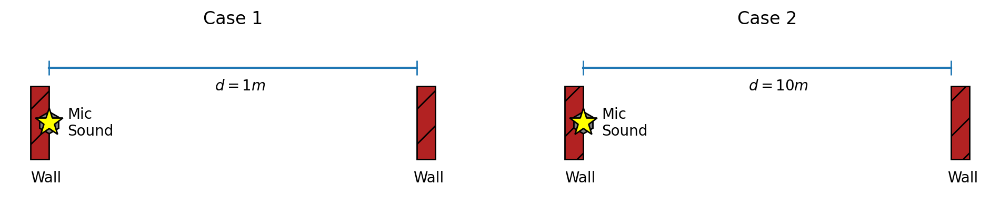

In [7]:
figure( figsize=(12,2), facecolor='w')
gcf().add_subplot( 1, 2, 1, title='Case 1', frameon=False, xticks=[], yticks=[])
gca().plot( 0, 0, 'h', color='grey', markeredgecolor='k', markersize=15)
gca().plot( 0, 0, '*', color='yellow', markeredgecolor='k', markersize=20)
gca().plot( [0,1], [.15,.15], marker='|', markersize=10)
gca().add_patch( Rectangle( (1,-.1), .05, .2, facecolor='firebrick', edgecolor='k', hatch='/'))
gca().add_patch( Rectangle( (0,-.1), -.05, .2, facecolor='firebrick', edgecolor='k', hatch='/'))
[gca().text(x+.05,y,t,va='center',ha='left') 
    for x,y,t in zip( [0,.4,.94,-.1], [0,.1,-.15,-.15], ['Mic\nSound','$d=1m$','Wall','Wall'])]
gca().axis( 'equal')

gcf().add_subplot( 1, 2, 2, title='Case 2', frameon=False, xticks=[], yticks=[])
gca().plot( 0, 0, 'h', color='grey', markeredgecolor='k', markersize=15)
gca().plot( 0, 0, '*', color='yellow', markeredgecolor='k', markersize=20)
gca().plot( [0,1], [.15,.15], marker='|', markersize=10)
gca().add_patch( Rectangle( (1,-.1), .05, .2, facecolor='firebrick', edgecolor='k', hatch='/'))
gca().add_patch( Rectangle( (0,-.1), -.05, .2, facecolor='firebrick', edgecolor='k', hatch='/'))
[gca().text(x+.05,y,t,va='center',ha='left') 
    for x,y,t in zip( [0,.4,.94,-.1], [0,.1,-.15,-.15], ['Mic\nSound','$d=10m$','Wall','Wall'])]
gca().axis( 'equal');

In [9]:
# YOUR CODE HERE

# function that models infinite reverb ... y[t] = x[t] + g y[t - N] ... comb filter
def infinite_echo(input_sound, sr, d, g):
    # calculate N (i.e. the delay)
    speed_of_sound = 343 # units are m/s
    N = int(((2 * d) / speed_of_sound) * sr)

    # set up denominator for convolution (recursive)
    a = np.zeros(N + 1)
    a[0] = 1
    a[-1] = -g

    # compute reverb
    reverb = scipy.signal.lfilter([1], a, input_sound)
    return reverb

# case 1: d=1m
infinite_reverb1 = infinite_echo(drum_x, drum_sr, 1, 0.55)
utils.sound(infinite_reverb1, drum_sr, "drum loop (case 1 - infinite reverb)")

# case 2: d=10m
infinite_reverb2 = infinite_echo(drum_x, drum_sr, 10, 0.5)
utils.sound(infinite_reverb2, drum_sr, "drum loop (case 2 - infinite reverb)")


drum loop (case 1 - infinite reverb)


drum loop (case 2 - infinite reverb)


What's different now is ... the filter sounds much more different between the short and long distances. The infinite echo with the shorter distance sounds more sharp/hollow, which might be due to the intereference of the echos with the drum sound. I don't really hear the echos in the shorter distance's sound whereas they are very prominent in the longer distance's sound. I'm also able to hear a lot more reverb with the 10m infinite echo than the simple reverb from before.

c) Since for small values of $d$ the output above gets its spectrum altered, we will use an allpass filter to make a more natural sounding echo pattern. Use the formulation shown in the lecture slides and compare that filter’s frequency response with the response from the filter in the section b) above.  How does the allpass filter sound when compared to the ones above?

In [10]:
# YOUR CODE HERE

# function that models reverb, avoiding spectral coloring ... y[t] = g x[t] + x[t - N] - g y[t - N]
def allpass_echo(input_sound, sr, d, g):
    # calculate N (i.e. the delay)
    speed_of_sound = 343 # units are m/s
    N = int(((2 * d) / speed_of_sound) * sr)

    # set up numerator for convolution (non-recursive) ... gx[t] + x[t - N]
    b = np.zeros(N + 1)
    b[0] = g
    b[-1] = 1
    
    # set up denominator for convolution (recursive) ... y[t] - g y[t - N]
    a = np.zeros(N + 1)
    a[0] = 1
    a[-1] = g

    # compute reverb
    reverb = scipy.signal.lfilter(b, a, input_sound)
    w, h = scipy.signal.freqz(b, a, fs=sr)
    return reverb, w, h

# case 1: d=1m
allpass_reverb1, w1, h1 = allpass_echo(drum_x, drum_sr, 1, 0.6)
utils.sound(allpass_reverb1, drum_sr, "drum loop (case 1 - allpass reverb)")

# case 2: d=10m
allpass_reverb2, w2, h2 = allpass_echo(drum_x, drum_sr, 10, 0.5)
utils.sound(allpass_reverb2, drum_sr, "drum loop (case 2 - allpass reverb)")


drum loop (case 1 - allpass reverb)


drum loop (case 2 - allpass reverb)


This filter sounds ... better than the comb filter from above. The short distance allpass reverb doesn't have that sharp/hollow twinge to it that it did before. Both reverbs sound more full and realistic than the previous attempts. The longer distance allpass also sounds more natural than its comb counterpart, which I now notice more of its hollow sounding aspects when I listen to it compared to the allpass.

## Part 2. Schroeder reverberators

Now we will combine multiple filters to make a more serious sounding reverb. Implement the structure shown in slide 24 of the reverb lecture (the page is titled "*Wetness of reverb*").

Try to find the necessary parameters for the above structure that makes it sound as good as possible (not too busy, not too subtle). Hint: There is no right answer! Try a few things, see what sounds best and explain why you used the parameters you decided to use. As you come across some bad sounding cases, describe what the problem was.

In [11]:
# YOUR CODE HERE

# function that models comb filter (infinite reverb) ... y[t] = x[t] + g y[t - N] ... comb filter
def comb_filter(input_sound, N, g):
    # set up denominator for convolution (non-recursive)
    a = np.zeros(N + 1)
    a[0] = 1
    a[-1] = -g

    # compute reverb
    reverb = scipy.signal.lfilter([1], a, input_sound)
    return reverb

# function that models allpass filter ... y[t] = x[t] + g y[t - N]
def allpass_filter(input_sound, N, g):
    # set up numerator for convolution (non-recursive) ... gx[t] + x[t - N]
    b = np.zeros(N + 1)
    b[0] = g
    b[-1] = 1
    
    # set up denominator for convolution (recursive) ... y[t] - g y[t - N]
    a = np.zeros(N + 1)
    a[0] = 1
    a[-1] = g

    # compute reverb
    reverb = scipy.signal.lfilter(b, a, input_sound)
    return reverb

# function that uses the Schroeder model for reverb
def schroeder_echo(input_sound, sr, dry, g):

    # sum three Comb filters
    reverb = 0
    for i in range(3):
        N = int(sr / (10 * 3**i))
        reverb += comb_filter(input_sound, N, g)

    # apply two Allpass filters in sequence
    reverb = allpass_filter(reverb, int(sr / (10 * 3**3)), g)
    reverb = allpass_filter(reverb, int(sr / (10 * 3**4)), g)

    # Add dry input sound to final reverb
    return reverb + (dry * input_sound)

# play around
schroeder_reverb1 = schroeder_echo(drum_x, drum_sr, dry=0.38, g=0.55)
utils.sound(schroeder_reverb1, drum_sr, "drum loop (good - schroeder reverb)")

schroeder_reverb2 = schroeder_echo(drum_x, drum_sr, dry=0.25, g=0.75)
utils.sound(schroeder_reverb2, drum_sr, "drum loop (bad 1 - schroeder reverb)")

schroeder_reverb3 = schroeder_echo(drum_x, drum_sr, dry=0.7, g=0.3)
utils.sound(schroeder_reverb3, drum_sr, "drum loop (bad 2 - schroeder reverb)")

drum loop (good - schroeder reverb)


drum loop (bad 1 - schroeder reverb)


drum loop (bad 2 - schroeder reverb)


Here's what worked and what didn't for me ... using higher g values (>0.65) resulted in a reverb that was too strong and overpowered the original drum sound. On the other hand, using lower g values (< 0.4) resulted in almost no audible reverb, which wasn't desirable either. For the dry parameter, I found that using a value in the range 0.3-0.5 resulted in the best sounds because it had a good blend of the original sound and the reverb. My favorite result used the values of dry=0.38 and g=0.55, which made a natural sounding reverb. A bad result with values dry=0.25 and g=0.75 had way too much reverb and the drums sounded really far away. Another bad result with values dry=0.7 and g=0.3 had basically no reverb and sounded like the original audio. 

## Part 3. Applying a real room response

To apply a more realistic filter we need to use a real room response. Download the St. Andrew’s church room impulse response (Stereo) from:

[ https://openairlib.net/?page_id=683 ]
    
Make sure that the sound you will convolve with it will be at the same sampling rate. This impulse response captures that church’s RIR using two channels. To synthesize a sound in that room you need to convolve it with the impulse response. If your test sound is a single-channel recording, you can simply convolve it with each of the two impulse responses and then use the resulting outputs as the left and right channel. You will notice that using the ```scipy.signal.lfilter``` command for this operation can take very long to compute. For faster convolutions we need to perform this filtering in the frequency domain (using the fast convolution algorithm that we mentioned in the filtering lecture). The function ```numpy.convolve``` automatically does that (if you use an up to date version), otherwise you can directly use ```scipy.signal.fftconvolve```.  Verify that the resulting output sounds like it has been placed inside a church.


In [12]:
# YOUR CODE HERE

# load the Lady Gaga songs to play in a church setting (both are single channel)
judas_sr, judas_x = utils.wavreadfile("./data/judas.wav")
judas_x = judas_x[:judas_sr*15]

pokerface_sr, pokerface_x = utils.wavreadfile("./data/pokerface.wav")
pokerface_x = pokerface_x[pokerface_sr*48:pokerface_sr*65]

# load the impulse response sound
room_sr, room_x = utils.wavreadfile("./data/impulse_response.wav")
print("Sample rates: ", room_sr, judas_sr, pokerface_sr)

# convolve the room impulse with the songs
room_transpose = room_x.T
channel1 = room_transpose[0]
channel2 = room_transpose[1]
output1 = np.vstack((np.convolve(judas_x, channel1), np.convolve(judas_x, channel2)))
output2 = np.vstack((np.convolve(pokerface_x, channel1), np.convolve(pokerface_x, channel2)))

# play the sounds
utils.sound(room_x.T, room_sr, "Church impulse response")
utils.sound(judas_x, judas_sr, "Judas (original)")
utils.sound(pokerface_x, pokerface_sr, "Pokerface (original)")
utils.sound(output1, room_sr, "Judas (in a church)")
utils.sound(output2, room_sr, "Pokerface (in a church)")

Sample rates:  48000 48000 48000


Church impulse response


Judas (original)


Pokerface (original)


Judas (in a church)


Pokerface (in a church)


## Part 4 (for 4-hour credit students). Measuring a room response.

Measuring a room response is crucial when trying to emulate a real room. In this exercise we will make a simple room response measurement. We will use a technique similar to the one shown in the lecture slides.

a) Generate a chirp to use as our room excitation signal $x[t]$.  It should go from 0 to Nyquist in about a third of a second.  Zero pad it from the front and the back to make it be about 2 seconds long.

b) Go to a (preferably quiet) room that you want to measure, play the chirp from a speaker and record the outcome.  The easiest way to do that is to save this sequence as a wave file and play it while you record a new sound file, or for better results you can instead use the real-time I/O code from Lab 0 to play and record the sound simultaneously. Either way you will obtain the sequence $y[t]$ from slide 34.

c) Now you will need to perform the actual deconvolution. Take $x[t]$ and $y[t]$, compute their DFTs to get $X[ω]$ and $Y[ω]$, and estimate $H[ω]$ as shown in slide 36. If you recorded the audio manually you will need to trim the recording to be the same size as the input.  Take the inverse DFT of $H$ to get the time domain representation of the room impulse response. Plot it; does it look like a legit room response?

d) Convolve the resulting response with the test sound above (make sure you use the same sample rates). Does it sound reverberated? This won’t be perfect. What sounds “wrong” with it? Can you speculate why?

In [ ]:
# YOUR CODE HERE
raise NotImplementedError()

The estimated response looks like ... *[fill in here]*

The sound sounds wrong because ... *[fill in here]*